In [1]:
import pandas as pd
import plotly
from plotly.colors import n_colors
import plotly.graph_objs as go
import plotly.express as px
import numpy as np

#### Carregando os datasets

In [2]:
#dataset SRAG já categorizada pelo dicionário de dados
df_srag = pd.read_csv('srag_final2.csv', sep=';', low_memory=False)
df_srag.head()

,DT_NOTIFIC,SEM_NOT,CS_SEXO,NU_IDADE_N,SG_UF_NOT,HOSPITAL,UTI,CLASSI_FIN,EVOLUCAO
0,2020-07-08,28,M,57,SP,Sim,Não,SRAG por COVID-19,Cura
1,2020-07-08,28,M,24,SP,Sim,Não,SRAG por COVID-19,Cura
2,2020-07-08,28,M,76,SP,Sim,Não,SRAG por COVID-19,Cura
3,2020-07-08,28,M,52,SP,Sim,Não,SRAG por COVID-19,Cura
4,2020-07-08,28,M,40,SP,Sim,Não,SRAG por COVID-19,Cura


In [7]:
#Este dataset vai servir no gráfico de linha (média movel)
df_covid_diario = pd.read_csv("df_covid_diario.csv")
df_covid_diario.tail(10)

,date,newDeaths,newCases,medMovel_newCases,medMovel_newDeaths
547,2021-08-25,887,29979,26705.000000,717.714286
548,2021-08-26,871,30923,25977.857143,696.000000
549,2021-08-27,818,27756,25055.428571,685.142857
550,2021-08-28,629,22947,24716.142857,687.714286
551,2021-08-29,278,11263,24333.000000,679.857143
552,2021-08-30,318,12801,23925.428571,665.714286
553,2021-08-31,881,26846,23216.428571,668.857143
554,2021-09-01,697,25748,22612.000000,641.714286
555,2021-09-02,756,26190,21935.857143,625.285714
556,2021-09-03,0,0,17970.714286,508.428571


### GRÁFICO DE BARRAS COM DADOS RANDÔMICOS

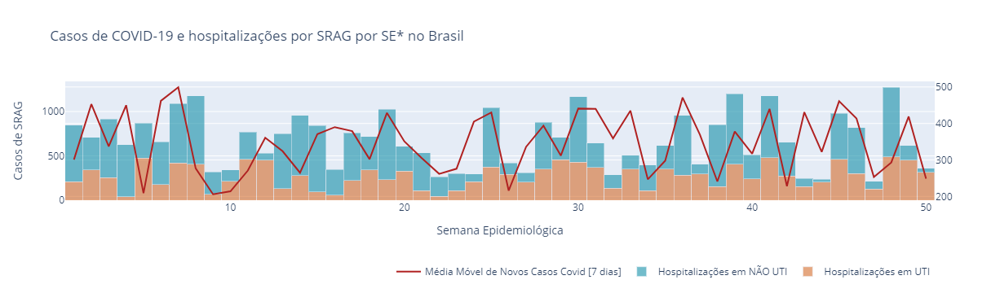

In [10]:
colors = {'A':'#d46c2c',
          'B':'#1490a8','C':'#b02121'}

semana_epidemiologica = []

i = 1
while len(semana_epidemiologica) < 50:
    semana_epidemiologica.append(i)
    i += 1
    
x = semana_epidemiologica

trace1 = go.Bar(
    x=semana_epidemiologica,
    y=np.random.randint(low=1, high=500, size=len(semana_epidemiologica)),
    name='Hospitalizações em UTI', 
    marker_color=colors['A'],
    opacity=0.6,
    )

trace2 = go.Bar(
    x=semana_epidemiologica,
    y=np.random.randint(low=1, high=800, size=len(semana_epidemiologica)),
    name='Hospitalizações em NÃO UTI',
    marker_color=colors['B'],
    opacity=0.6,
    )

trace3 = go.Scatter(
    x=semana_epidemiologica,
    y=np.random.randint(low=200, high=500, size=len(semana_epidemiologica)),
    name='Média Móvel de Novos Casos Covid [7 dias]',
    marker_color=colors['C'], 
    yaxis='y2'
    )

data=[trace1, trace2, trace3]

layout= go.Layout(
    barmode= 'stack',
    bargap=0.0,
    title='Casos de COVID-19 e hospitalizações por SRAG por SE* no Brasil',
    xaxis=dict(title='Semana Epidemiológica'),
    yaxis=dict(title='Casos de SRAG'),
    yaxis2=dict(overlaying='y',side='right')
    )
fig= go.Figure(data=data, layout=layout)
fig.update_layout(legend=dict(orientation="h", yanchor="bottom", y=-0.7, xanchor="right", x=1,))
fig.show()

#### GRÁFICO DE PIRÂMIDE ETÁRIA COM DADOS FICTÍCIOS

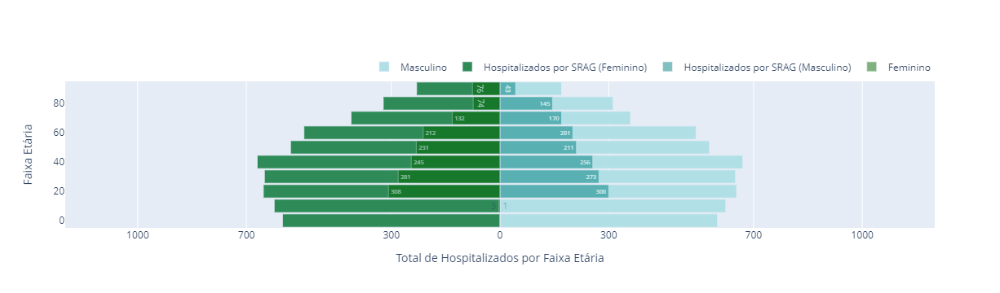

In [11]:
import numpy as np

pop_fem = np.array([-600, -623, -653, -650, -670, -578, -541, -411, -322, -230])
pop_masc = np.array([600, 623, 653, 650, 670, 578, 541, 360, 312, 170])
hosp_fem_srag = np.array([-0, -3, -308, -281, -245, -231, -212, -132, -74, -76])
hosp_masc_srag = np.array([0, 1, 300, 273, 256, 211, 201, 170, 145, 43])

y = list(range(0, 100, 10))

layout = go.Layout(yaxis=go.layout.YAxis(title='Faixa Etária'),
                   xaxis=go.layout.XAxis(
                       range=[-1200, 1200],
                       tickvals=[-1000, -700, -300, 0, 300, 700, 1000],
                       ticktext=[1000, 700, 300, 0, 300, 700, 1000],
                       title='Total de Hospitalizados por Faixa Etária'),
                   barmode='overlay',
                   bargap=0.1)

data = [go.Bar(y=y,
               x=pop_masc,
               orientation='h',
               name='Masculino',
               #text=+1 * men_bins.astype('int'),               
               hoverinfo='x',
               marker=dict(color='powderblue')
               ),
        go.Bar(y=y,
               x=pop_fem,
               orientation='h',
               name='Hospitalizados por SRAG (Feminino)',
               #text=-1 * women_bins.astype('int'),
               hoverinfo='text',
               marker=dict(color='seagreen')
               ),
        go.Bar(y=y,
               x=hosp_masc_srag,
               orientation='h',
               name='Hospitalizados por SRAG (Masculino)',
               text=+1 * hosp_masc_srag.astype('int'),
               hoverinfo='x',
               showlegend=True,
               opacity=0.5,
               marker=dict(color='teal')
               ),
        go.Bar(y=y,
               x=hosp_fem_srag,
               orientation='h',
               name='Feminino',
               text=-1 * hosp_fem_srag.astype('int'),
               hoverinfo='text',
               showlegend=True,
               opacity=0.5,
               marker=dict(color='darkgreen')
               )]

fig = go.Figure(data=data, layout=layout)
fig.update_layout(legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))
fig.show()

#### HISTOGRAMA DE HOSPITALIZAÇÕES POR SRAG E COVID-19 (UTI X NÃO UTI)

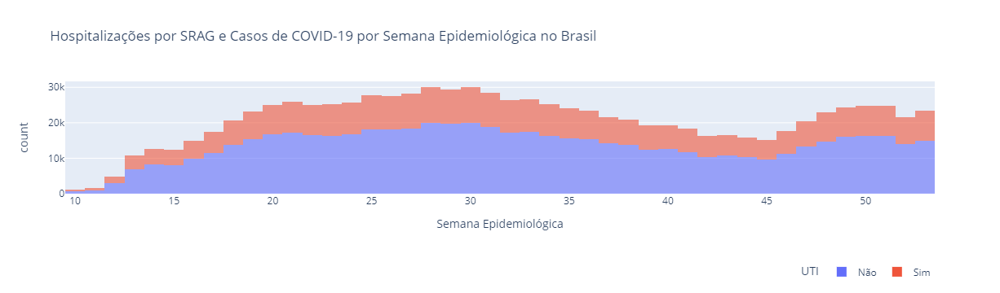

In [12]:
#import plotly.express as px
df = df_srag.query("SEM_NOT >=10")
fig = px.histogram(df, 
                   x = "SEM_NOT", 
                   color = "UTI", 
                   title = "Hospitalizações por SRAG e Casos de COVID-19 por Semana Epidemiológica no Brasil", 
                   opacity = 0.6, 
                   labels={'SEM_NOT':'Semana Epidemiológica', 'count':'Casos'}) 
fig.update_layout(legend = dict(orientation = "h", 
                                yanchor = "bottom", 
                                y = -0.80, 
                                xanchor = "right", 
                                x = 1))
fig.show()

#### HISTOGRAMA POR CAUSAS DAS HOSPITALIZAÇÕES POR SRAG 

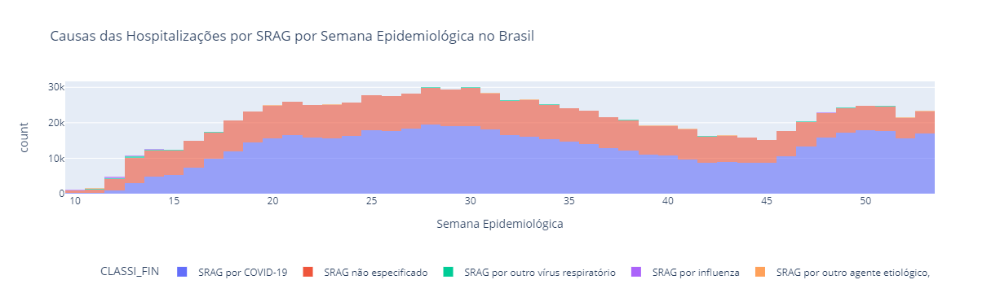

In [14]:
#df = df_srag.query("SEM_NOT >=10")
fig = px.histogram(df, 
                   x="SEM_NOT", 
                   color="CLASSI_FIN", 
                   title="Causas das Hospitalizações por SRAG por Semana Epidemiológica no Brasil", 
                   opacity=0.6, 
                   labels={'SEM_NOT':'Semana Epidemiológica'})
fig.update_layout(legend=dict(orientation="h",
                              yanchor="bottom", 
                              y=-0.80, 
                              xanchor="right", 
                              x=1))
#fig.update_layout(yaxis=dict(title='Total')
fig.show()